# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on the Celeb A dataset which is a large set of celebrity face images.

In [1]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [2]:
from gan.train import train

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076). 

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [4]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [5]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). 

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [6]:
from gan.models import Discriminator, Generator
from gan.utils import show_images

# Data loading: Celeb A Dataset

The CelebA images we provide have been filtered to obtain only images with clear faces and have been cropped and downsampled to 128x128 resolution.

In [7]:
batch_size = 128
scale_size = 64  # We resize the images to 64x64 for training

celeba_root = 'celeba_data'

In [8]:
celeba_train = ImageFolder(root=celeba_root, transform=transforms.Compose([
  transforms.Resize(scale_size),
  transforms.ToTensor(),
]))

celeba_loader_train = DataLoader(celeba_train, batch_size=batch_size, drop_last=True)

### Visualize dataset

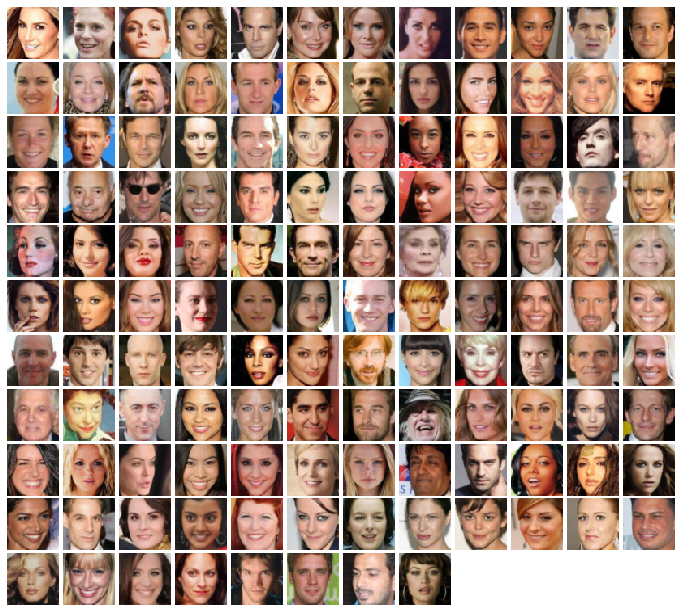

In [9]:
imgs = celeba_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [10]:
NOISE_DIM = 100
NUM_EPOCHS = 20
learning_rate = 0.0002

### Train GAN

In [11]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [12]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.464, G:1.657


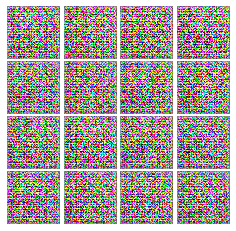


Iter: 150, D: 2.02, G:0.967


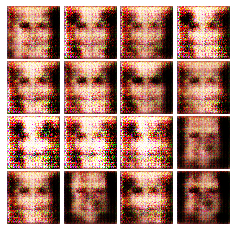


Iter: 300, D: 0.6194, G:1.018


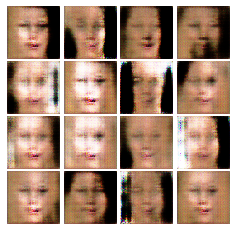


Iter: 450, D: 1.73, G:1.599


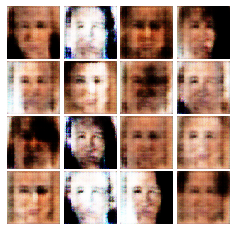


Iter: 600, D: 0.903, G:1.081


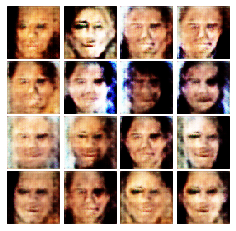


Iter: 750, D: 1.226, G:1.529


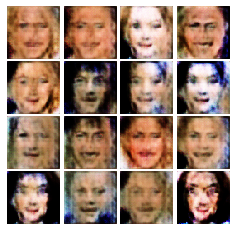


Iter: 900, D: 1.257, G:1.938


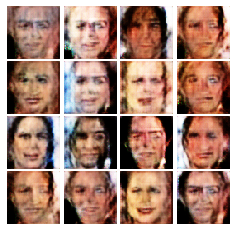


EPOCH:  2
Iter: 1050, D: 0.6876, G:1.014


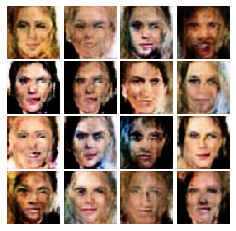


Iter: 1200, D: 1.271, G:0.8406


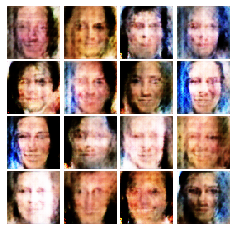


Iter: 1350, D: 1.109, G:1.557


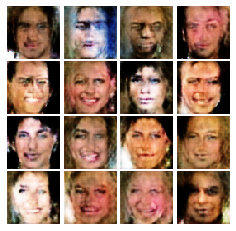


Iter: 1500, D: 1.307, G:0.8814


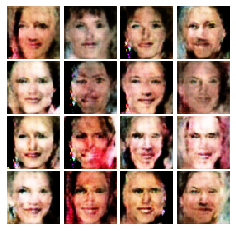


Iter: 1650, D: 1.734, G:1.961


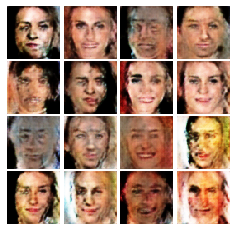


Iter: 1800, D: 1.236, G:1.042


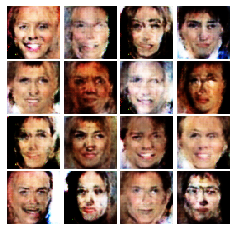


Iter: 1950, D: 1.066, G:1.112


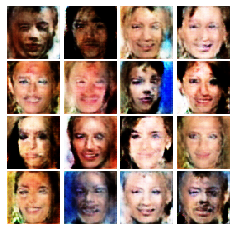


EPOCH:  3
Iter: 2100, D: 0.9213, G:0.8654


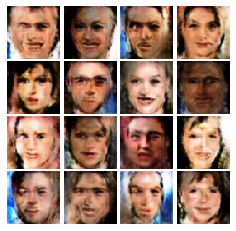


Iter: 2250, D: 1.207, G:0.9104


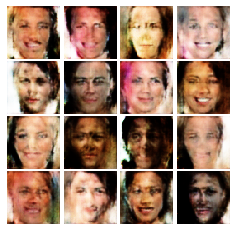


Iter: 2400, D: 1.431, G:1.206


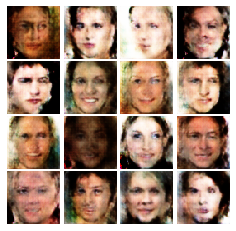


Iter: 2550, D: 0.7027, G:1.411


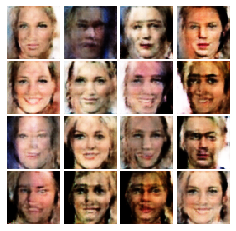


Iter: 2700, D: 0.9685, G:2.36


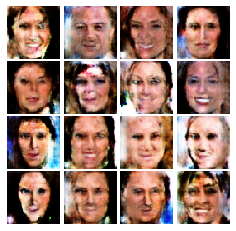


Iter: 2850, D: 2.375, G:2.196


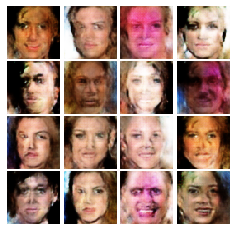


EPOCH:  4
Iter: 3000, D: 1.137, G:1.501


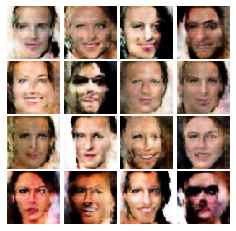


Iter: 3150, D: 0.3594, G:1.618


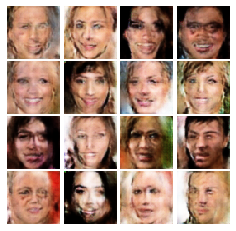


Iter: 3300, D: 1.002, G:0.7174


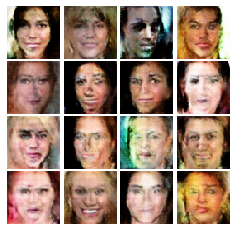


Iter: 3450, D: 1.332, G:2.558


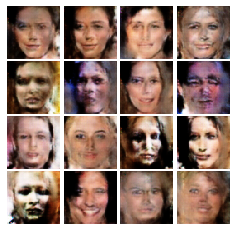


Iter: 3600, D: 0.09834, G:3.101


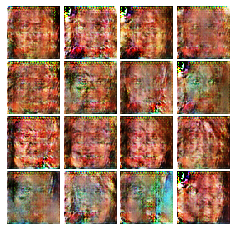


Iter: 3750, D: 0.3358, G:1.876


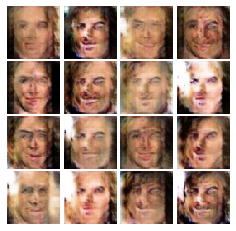


Iter: 3900, D: 0.2329, G:1.996


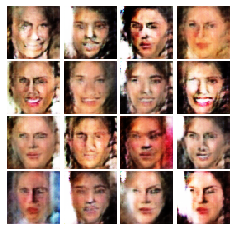


EPOCH:  5
Iter: 4050, D: 0.316, G:1.909


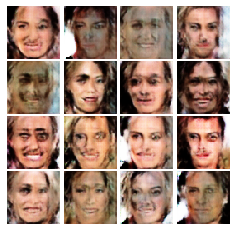


Iter: 4200, D: 0.6983, G:2.046


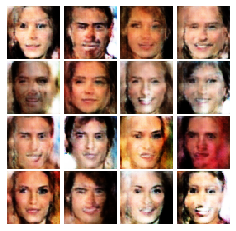


Iter: 4350, D: 0.9622, G:1.724


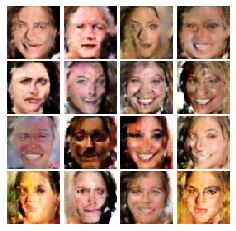


Iter: 4500, D: 3.14, G:2.501


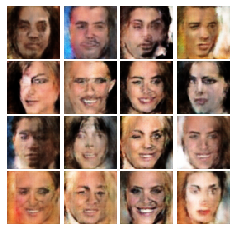


Iter: 4650, D: 1.3, G:4.449


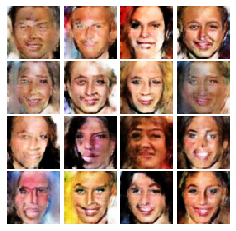


Iter: 4800, D: 0.4875, G:1.936


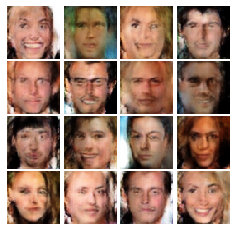


EPOCH:  6
Iter: 4950, D: 0.2952, G:1.45


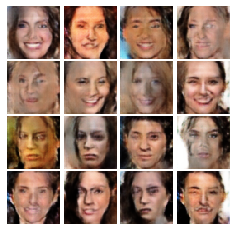


Iter: 5100, D: 0.8626, G:0.8443


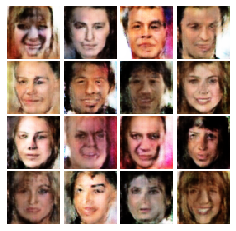


Iter: 5250, D: 1.073, G:1.008


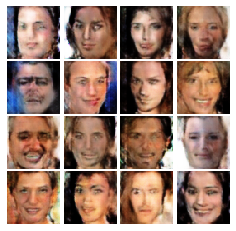


Iter: 5400, D: 2.177, G:3.536


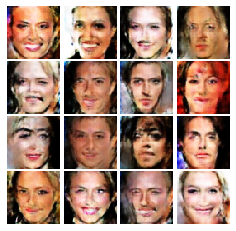


Iter: 5550, D: 1.256, G:0.993


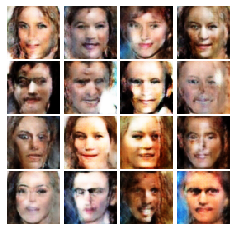


Iter: 5700, D: 0.4067, G:1.31


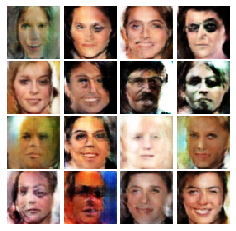


Iter: 5850, D: 0.4726, G:2.294


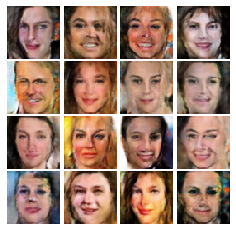


EPOCH:  7
Iter: 6000, D: 1.264, G:2.196


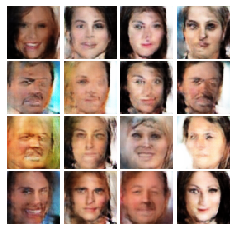


Iter: 6150, D: 0.4518, G:1.724


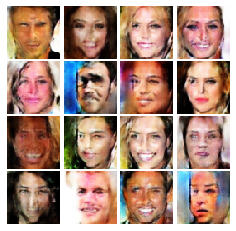


Iter: 6300, D: 0.7231, G:1.048


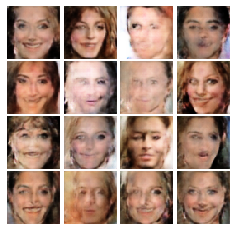


Iter: 6450, D: 0.3361, G:1.789


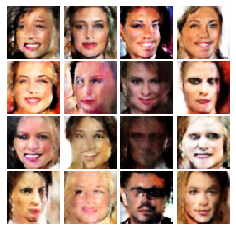


Iter: 6600, D: 0.2997, G:1.753


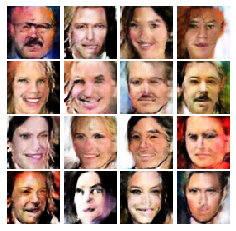


Iter: 6750, D: 0.2755, G:1.758


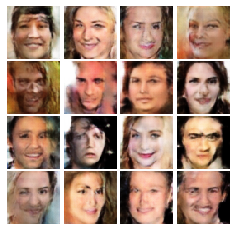


Iter: 6900, D: 0.7968, G:0.7679


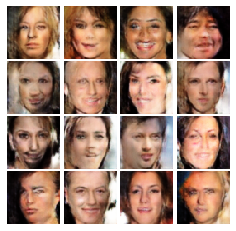


EPOCH:  8
Iter: 7050, D: 0.4296, G:1.447


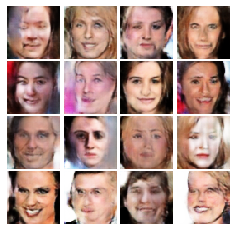


Iter: 7200, D: 0.5092, G:2.037


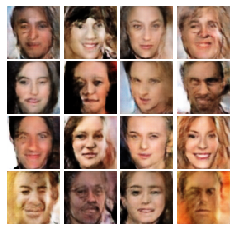


Iter: 7350, D: 0.1429, G:2.129


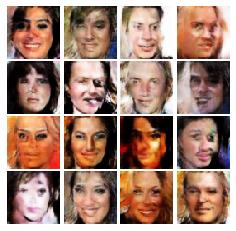


Iter: 7500, D: 0.6065, G:1.422


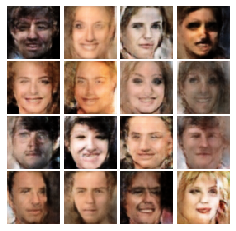


Iter: 7650, D: 0.4426, G:1.706


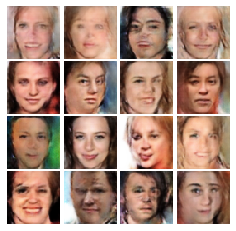


Iter: 7800, D: 0.1263, G:2.653


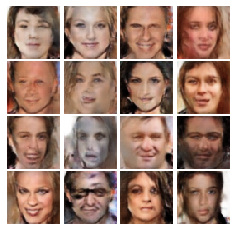


EPOCH:  9
Iter: 7950, D: 0.2434, G:1.974


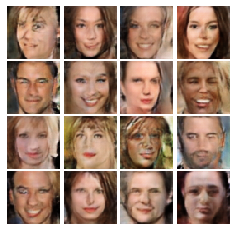


Iter: 8100, D: 0.8271, G:1.545


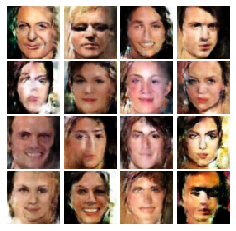


Iter: 8250, D: 0.625, G:1.582


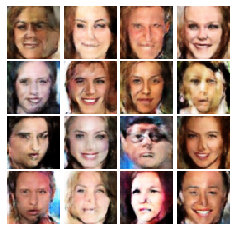


Iter: 8400, D: 0.2983, G:2.637


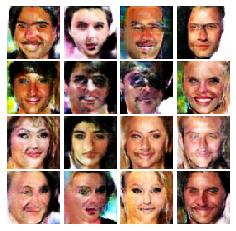


Iter: 8550, D: 0.9337, G:1.953


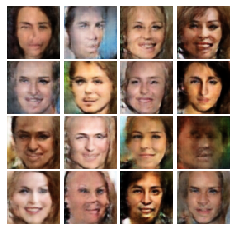


Iter: 8700, D: 0.3386, G:2.622


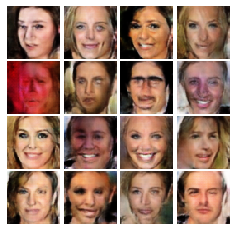


Iter: 8850, D: 0.4153, G:1.322


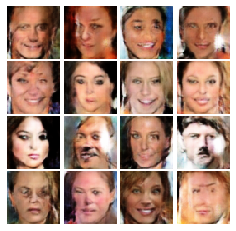


EPOCH:  10
Iter: 9000, D: 0.6444, G:1.637


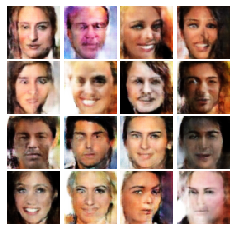


Iter: 9150, D: 1.017, G:3.149


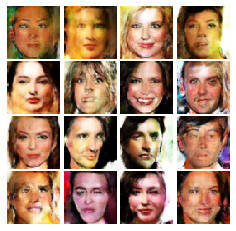


Iter: 9300, D: 0.5907, G:1.565


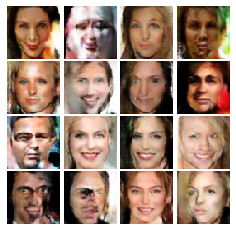


Iter: 9450, D: 1.484, G:6.324


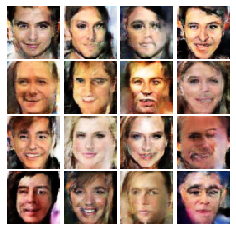


Iter: 9600, D: 0.4214, G:2.366


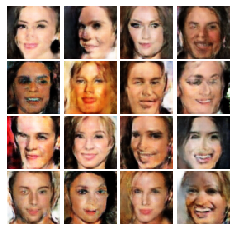


Iter: 9750, D: 0.5991, G:1.522


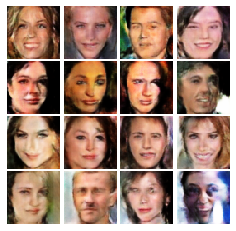


EPOCH:  11
Iter: 9900, D: 0.43, G:0.5672


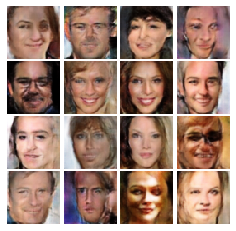


Iter: 10050, D: 1.078, G:1.193


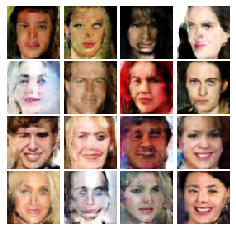


Iter: 10200, D: 0.4109, G:1.694


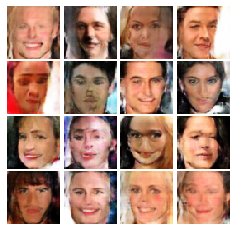


Iter: 10350, D: 0.3879, G:1.614


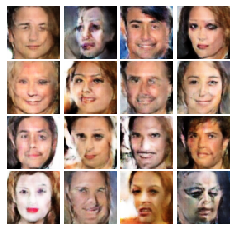


Iter: 10500, D: 0.2024, G:2.377


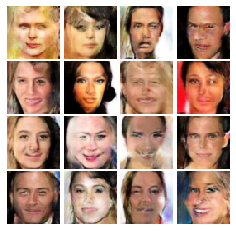


Iter: 10650, D: 0.1679, G:1.773


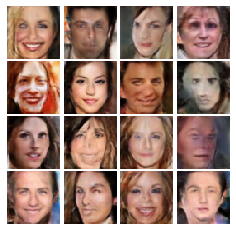


Iter: 10800, D: 0.2676, G:2.325


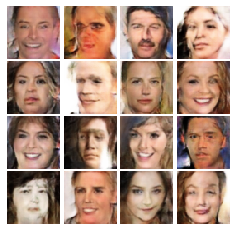


EPOCH:  12
Iter: 10950, D: 0.4248, G:1.353


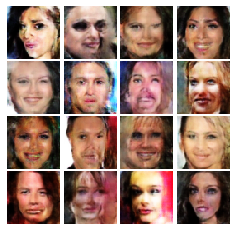


Iter: 11100, D: 0.6532, G:1.551


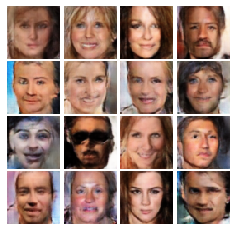


Iter: 11250, D: 0.5972, G:2.709


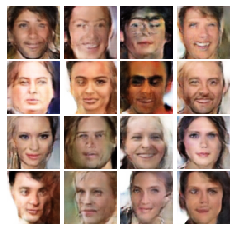


Iter: 11400, D: 0.3836, G:1.084


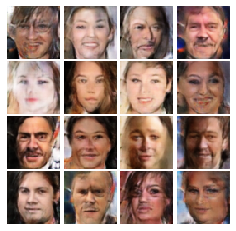


Iter: 11550, D: 0.4001, G:2.916


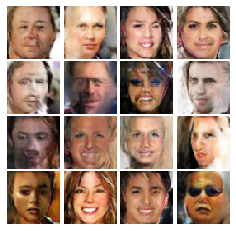


Iter: 11700, D: 0.2566, G:2.09


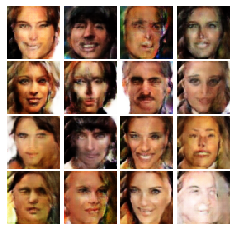


EPOCH:  13
Iter: 11850, D: 0.3012, G:2.051


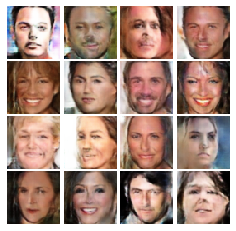


Iter: 12000, D: 1.167, G:3.22


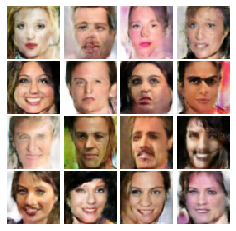


Iter: 12150, D: 1.282, G:1.513


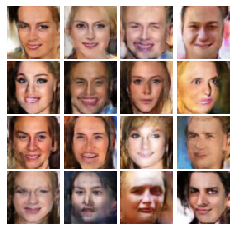


Iter: 12300, D: 0.1498, G:2.268


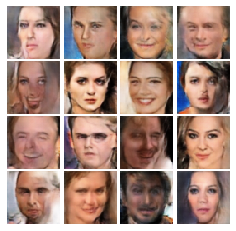


Iter: 12450, D: 0.1043, G:3.187


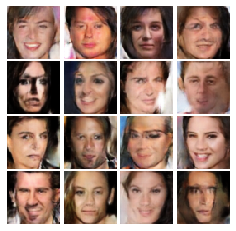


Iter: 12600, D: 0.2334, G:2.306


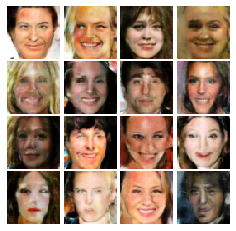


Iter: 12750, D: 0.8647, G:0.9608


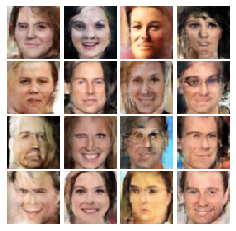


EPOCH:  14
Iter: 12900, D: 0.36, G:2.677


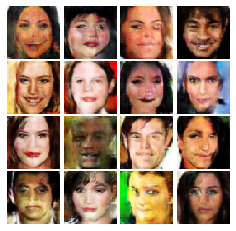


Iter: 13050, D: 0.04717, G:2.132


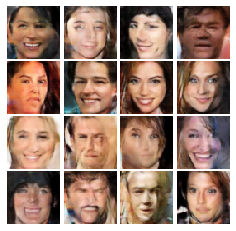


Iter: 13200, D: 0.637, G:2.353


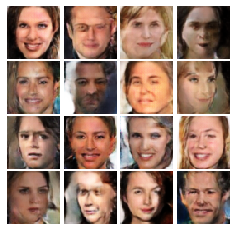


Iter: 13350, D: 3.16, G:3.323


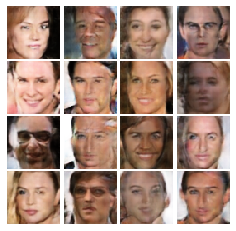


Iter: 13500, D: 0.2049, G:3.485


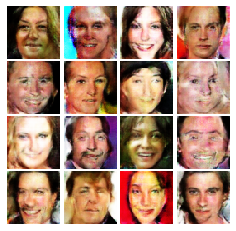


Iter: 13650, D: 0.9439, G:1.394


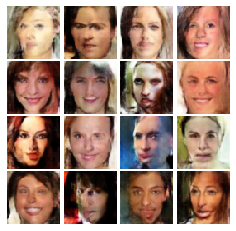


Iter: 13800, D: 0.06242, G:2.482


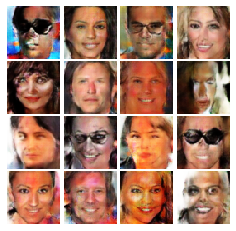


EPOCH:  15
Iter: 13950, D: 1.794, G:3.681


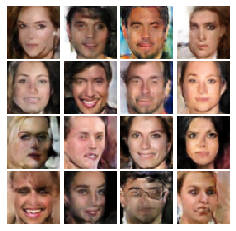


Iter: 14100, D: 0.04406, G:1.897


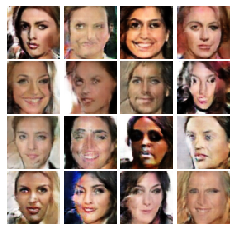


Iter: 14250, D: 0.4541, G:2.016


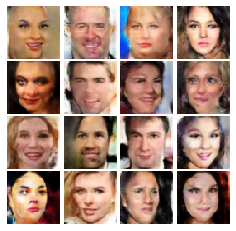


Iter: 14400, D: 0.3017, G:2.797


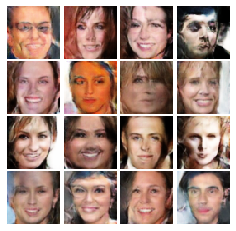


Iter: 14550, D: 0.1358, G:3.47


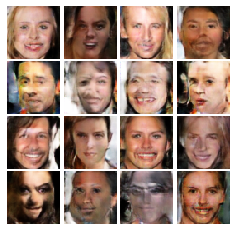


Iter: 14700, D: 0.6057, G:1.735


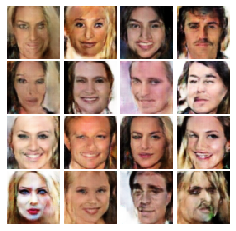


EPOCH:  16
Iter: 14850, D: 0.1134, G:2.874


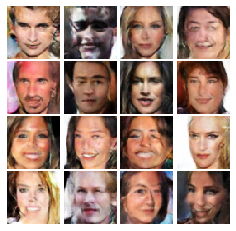


Iter: 15000, D: 0.1331, G:3.937


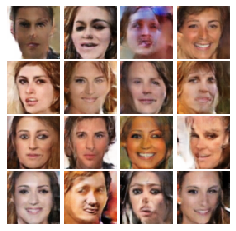


Iter: 15150, D: 0.5647, G:1.132


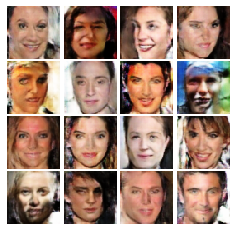


Iter: 15300, D: 1.03, G:2.118


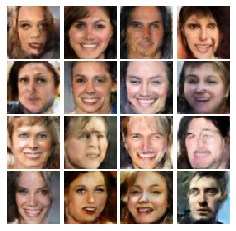


Iter: 15450, D: 0.2469, G:1.417


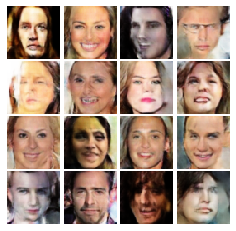


Iter: 15600, D: 0.02554, G:3.541


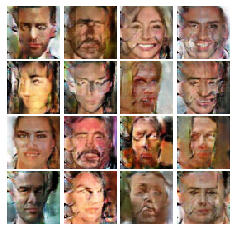


Iter: 15750, D: 0.1647, G:2.997


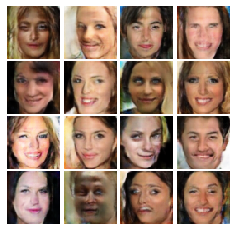


EPOCH:  17
Iter: 15900, D: 0.3554, G:2.816


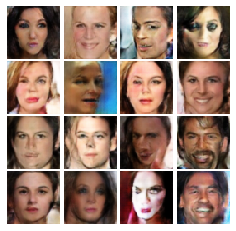


Iter: 16050, D: 0.6715, G:2.346


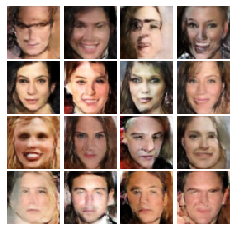


Iter: 16200, D: 1.063, G:4.008


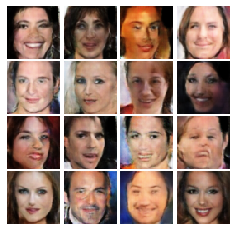


Iter: 16350, D: 0.2209, G:1.899


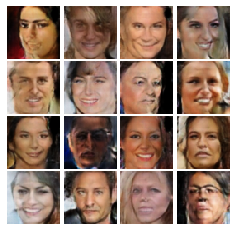


Iter: 16500, D: 0.771, G:1.552


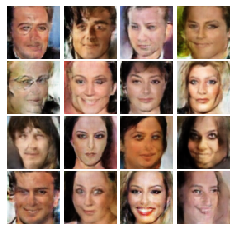


Iter: 16650, D: 0.2705, G:1.881


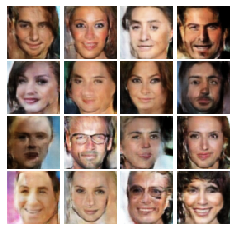


EPOCH:  18
Iter: 16800, D: 0.1388, G:2.795


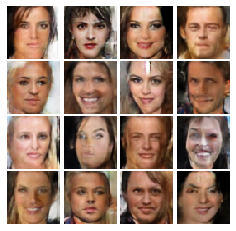


Iter: 16950, D: 0.2676, G:1.908


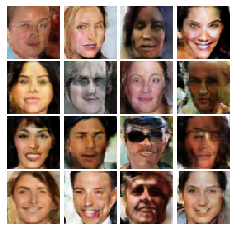


Iter: 17100, D: 0.3771, G:1.953


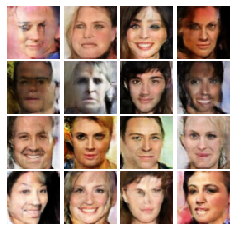


Iter: 17250, D: 0.6494, G:0.6692


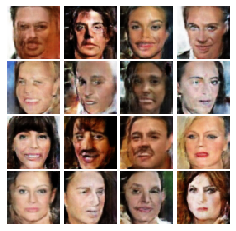


Iter: 17400, D: 0.3306, G:1.781


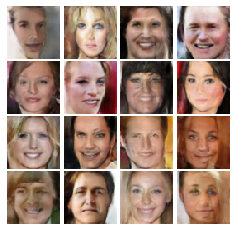


Iter: 17550, D: 0.03551, G:3.888


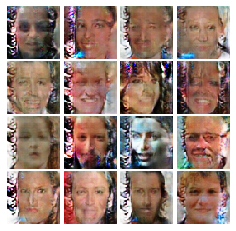


Iter: 17700, D: 0.06693, G:4.702


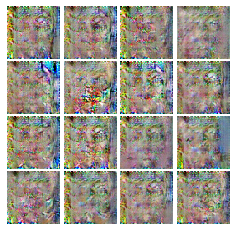


EPOCH:  19
Iter: 17850, D: 0.009481, G:5.33


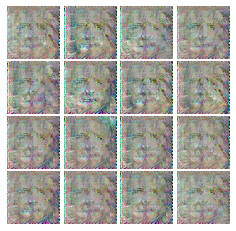


Iter: 18000, D: 0.01245, G:4.865


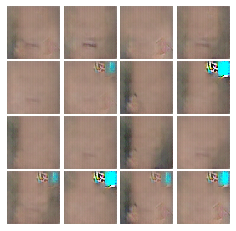


Iter: 18150, D: 0.02119, G:5.791


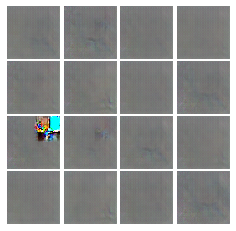


Iter: 18300, D: 0.009843, G:4.54


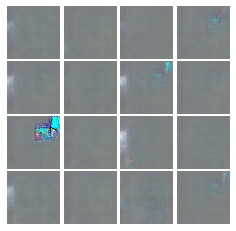


Iter: 18450, D: 0.009149, G:5.165


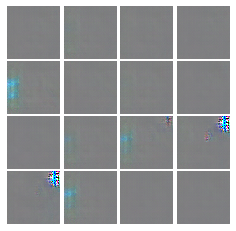


Iter: 18600, D: 0.002273, G:6.4


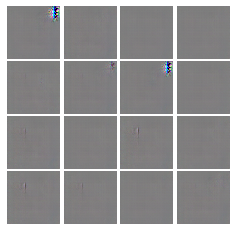


EPOCH:  20
Iter: 18750, D: 0.002437, G:6.037


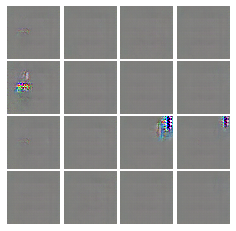


Iter: 18900, D: 0.002001, G:5.975


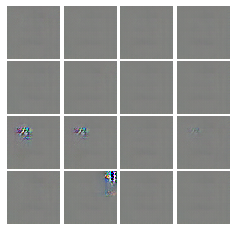


Iter: 19050, D: 0.003364, G:6.372


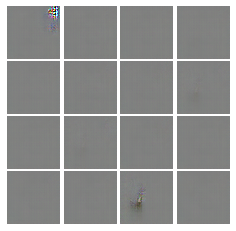


Iter: 19200, D: 0.001246, G:7.225


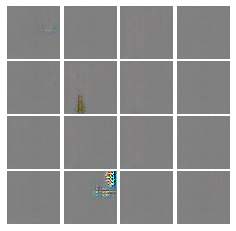


Iter: 19350, D: 0.001228, G:8.208


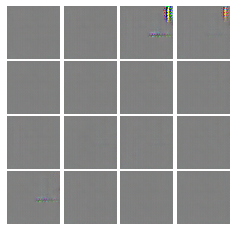


Iter: 19500, D: 0.0005417, G:9.039


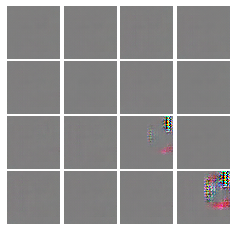


Iter: 19650, D: 0.0004107, G:7.368


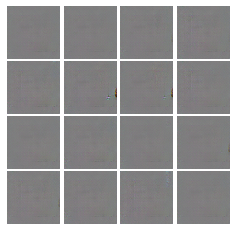

In [13]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
          generator_loss, num_epochs=NUM_EPOCHS, show_every=150,
          train_loader=celeba_loader_train, device=device)


### Train LS-GAN

In [14]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [15]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.4362, G:0.4558


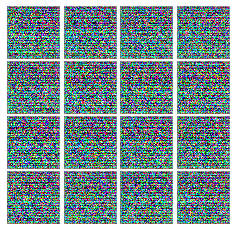


Iter: 200, D: 0.0661, G:0.5795


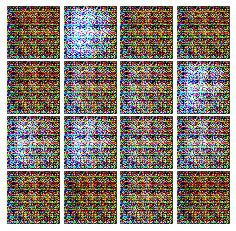


Iter: 400, D: 0.339, G:0.6594


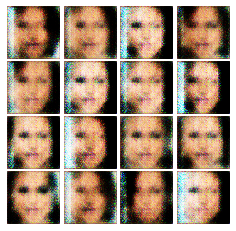


Iter: 600, D: 0.2305, G:0.5634


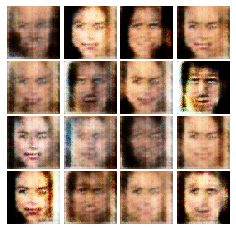


Iter: 800, D: 0.2127, G:0.4082


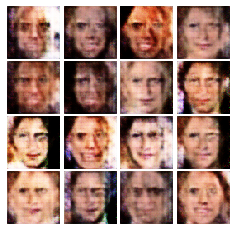


EPOCH:  2
Iter: 1000, D: 0.2164, G:0.3281


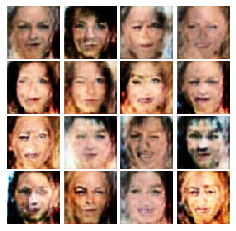


Iter: 1200, D: 0.3441, G:0.2332


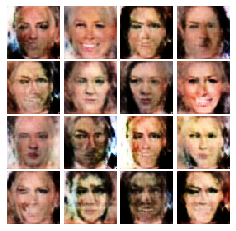


Iter: 1400, D: 0.09817, G:0.3072


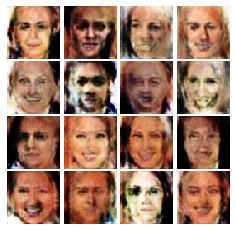


Iter: 1600, D: 0.2312, G:0.3964


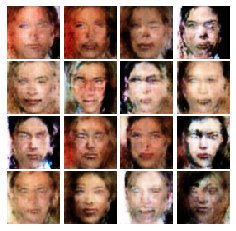


Iter: 1800, D: 0.1355, G:0.2753


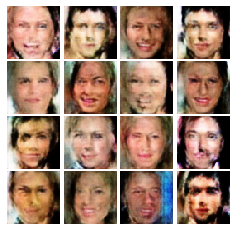


EPOCH:  3
Iter: 2000, D: 0.5475, G:0.6253


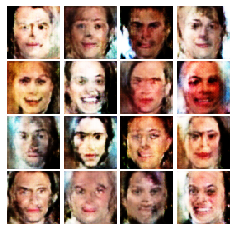


Iter: 2200, D: 0.2228, G:0.2453


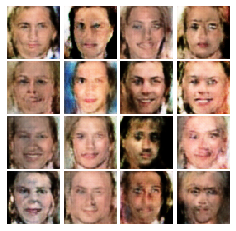


Iter: 2400, D: 0.2264, G:0.4445


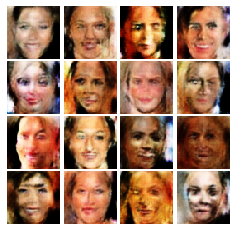


Iter: 2600, D: 0.1215, G:0.4077


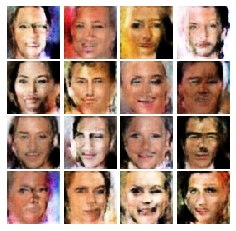


Iter: 2800, D: 0.08605, G:0.3868


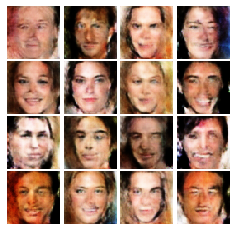


EPOCH:  4
Iter: 3000, D: 0.0799, G:0.3869


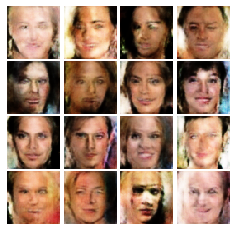


Iter: 3200, D: 0.2127, G:0.4566


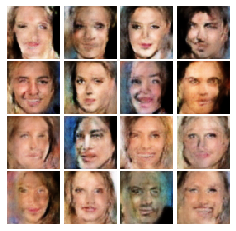


Iter: 3400, D: 0.1501, G:0.04546


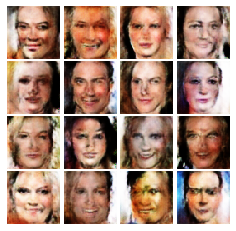


Iter: 3600, D: 0.08956, G:0.3933


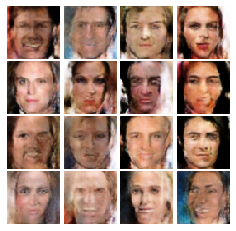


Iter: 3800, D: 0.3306, G:0.2517


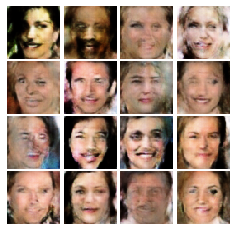


EPOCH:  5
Iter: 4000, D: 0.2568, G:0.3171


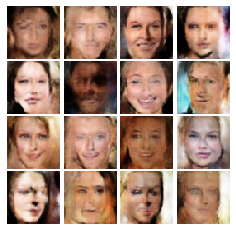


Iter: 4200, D: 0.07729, G:0.4654


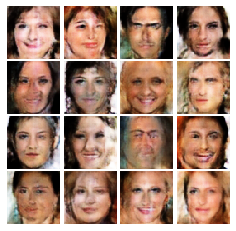


Iter: 4400, D: 0.07601, G:0.2966


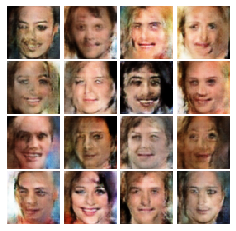


Iter: 4600, D: 0.1093, G:0.4639


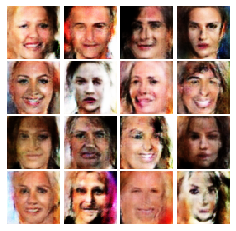


Iter: 4800, D: 0.1888, G:0.4456


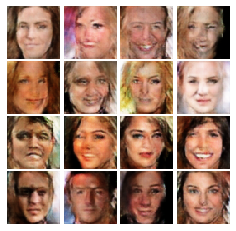


EPOCH:  6
Iter: 5000, D: 0.4484, G:0.6284


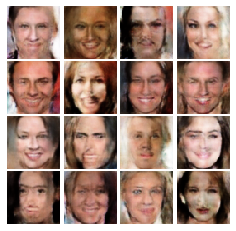


Iter: 5200, D: 0.04494, G:0.4941


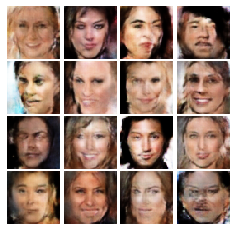


Iter: 5400, D: 0.09882, G:0.58


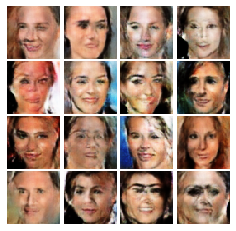


Iter: 5600, D: 0.2776, G:0.3491


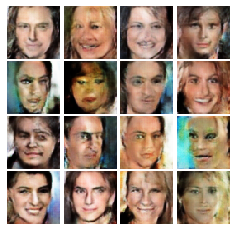


Iter: 5800, D: 0.1566, G:0.5997


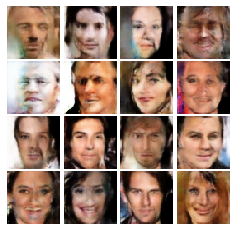


EPOCH:  7
Iter: 6000, D: 0.08092, G:0.4594


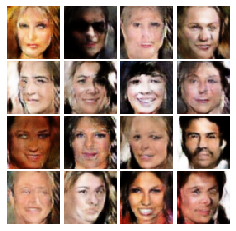


Iter: 6200, D: 0.09432, G:0.4319


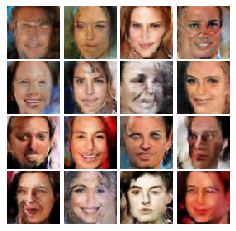


Iter: 6400, D: 0.1085, G:0.5077


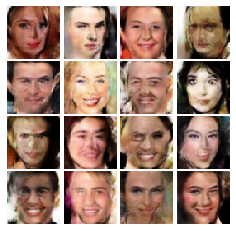


Iter: 6600, D: 0.1672, G:0.3766


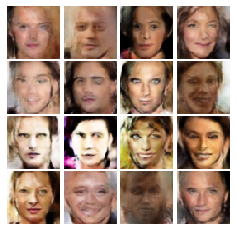


Iter: 6800, D: 0.1905, G:0.2217


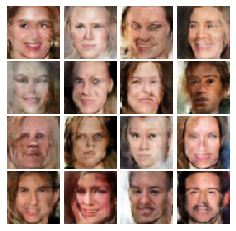


EPOCH:  8
Iter: 7000, D: 0.03669, G:0.5298


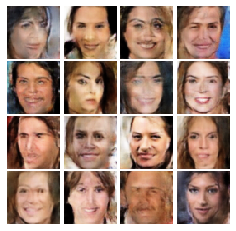


Iter: 7200, D: 0.1494, G:0.577


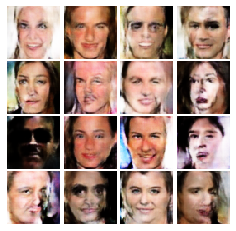


Iter: 7400, D: 0.05179, G:0.3796


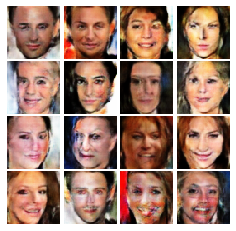


Iter: 7600, D: 0.03848, G:0.3565


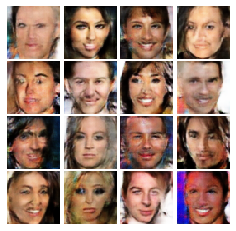


Iter: 7800, D: 0.08592, G:0.5211


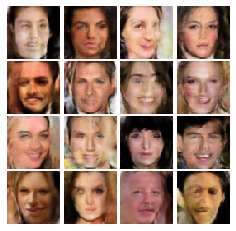


EPOCH:  9
Iter: 8000, D: 0.04964, G:0.372


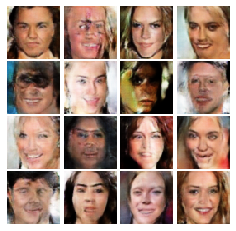


Iter: 8200, D: 0.06897, G:0.6246


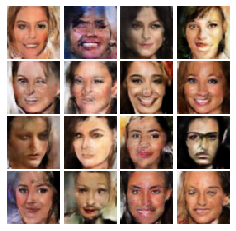


Iter: 8400, D: 0.01399, G:0.5104


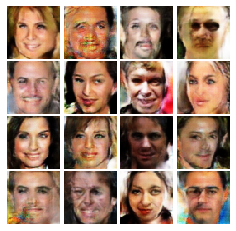


Iter: 8600, D: 0.1733, G:0.242


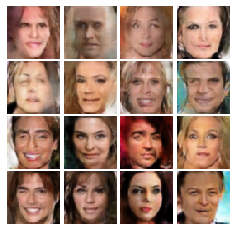


Iter: 8800, D: 0.1093, G:0.6027


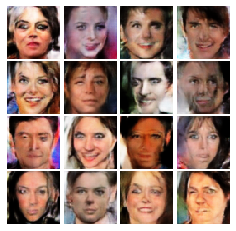


EPOCH:  10
Iter: 9000, D: 0.04121, G:0.4569


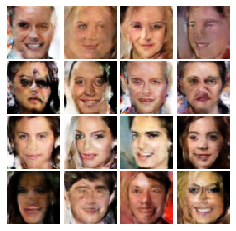


Iter: 9200, D: 0.02735, G:0.3321


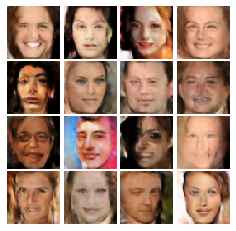


Iter: 9400, D: 0.01781, G:0.4927


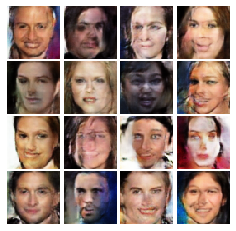


Iter: 9600, D: 0.08516, G:0.5696


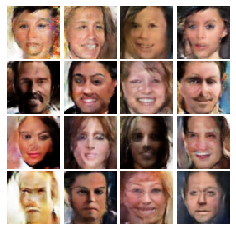


Iter: 9800, D: 0.1024, G:0.5227


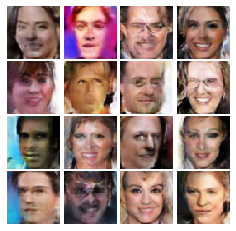


EPOCH:  11
Iter: 10000, D: 0.2012, G:0.6815


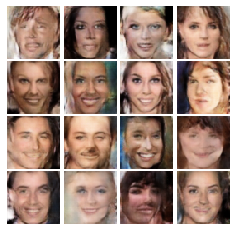


Iter: 10200, D: 0.1283, G:0.3938


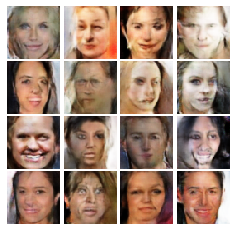


Iter: 10400, D: 0.03169, G:0.5401


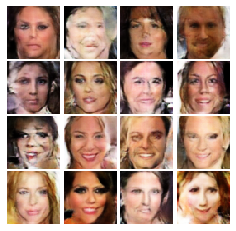


Iter: 10600, D: 0.02146, G:0.6212


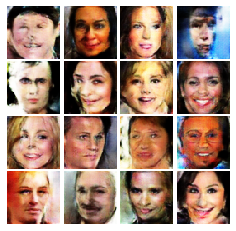


Iter: 10800, D: 0.2561, G:0.3303


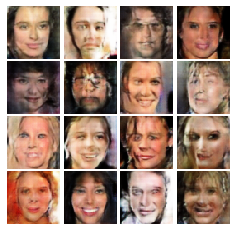


EPOCH:  12
Iter: 11000, D: 0.04259, G:0.491


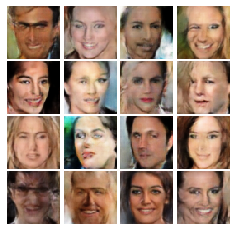


Iter: 11200, D: 0.04235, G:0.5526


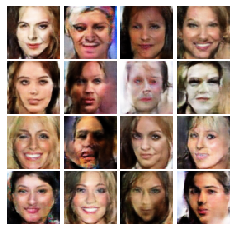


Iter: 11400, D: 0.05569, G:0.4133


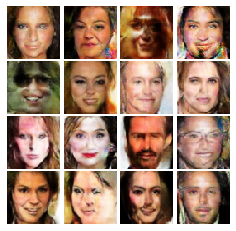


Iter: 11600, D: 0.1118, G:0.5636


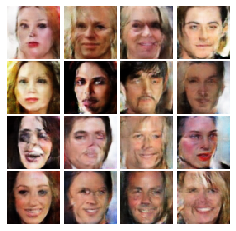


Iter: 11800, D: 0.08836, G:0.3483


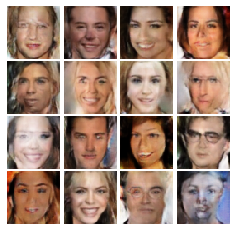


EPOCH:  13
Iter: 12000, D: 0.02092, G:0.526


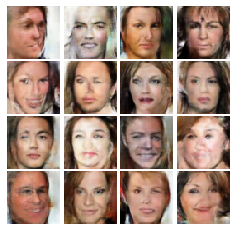


Iter: 12200, D: 0.03227, G:0.5012


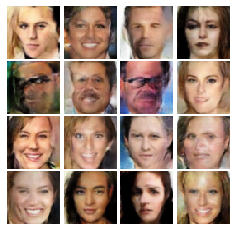


Iter: 12400, D: 0.02163, G:0.395


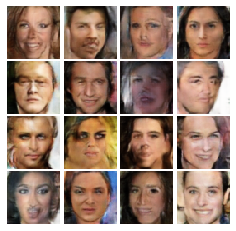


Iter: 12600, D: 0.01844, G:0.5567


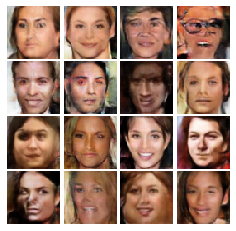


Iter: 12800, D: 0.04089, G:0.5348


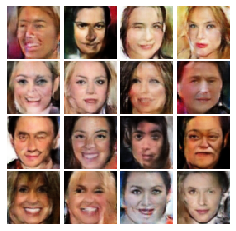


EPOCH:  14
Iter: 13000, D: 0.294, G:0.2261


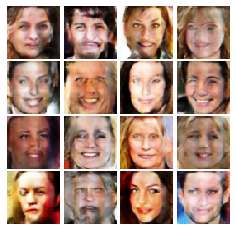


Iter: 13200, D: 0.2228, G:0.5846


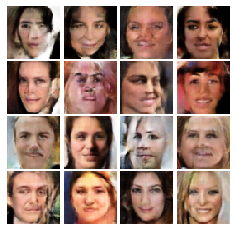


Iter: 13400, D: 0.01325, G:0.4521


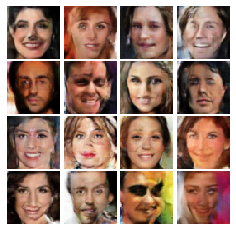


Iter: 13600, D: 0.03959, G:0.5676


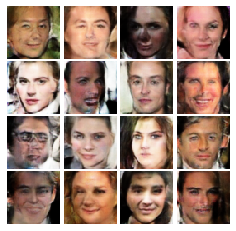


Iter: 13800, D: 0.04175, G:0.5466


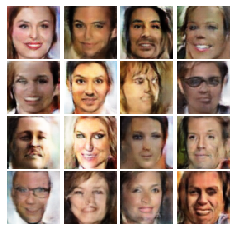


EPOCH:  15
Iter: 14000, D: 0.03047, G:0.5441


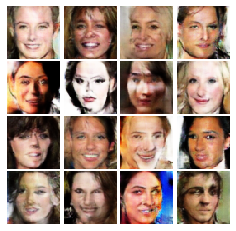


Iter: 14200, D: 0.04448, G:0.4705


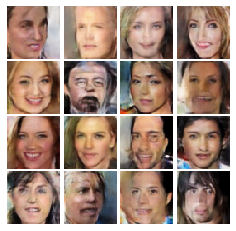


Iter: 14400, D: 0.01795, G:0.5664


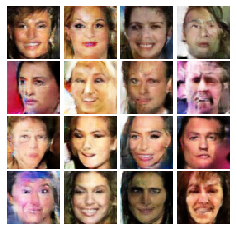


Iter: 14600, D: 0.01226, G:0.4454


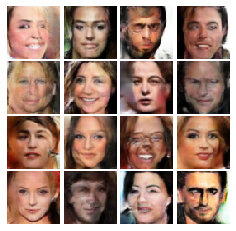


EPOCH:  16
Iter: 14800, D: 0.2488, G:0.2102


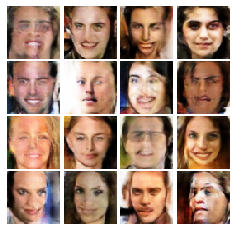


Iter: 15000, D: 0.03378, G:0.4734


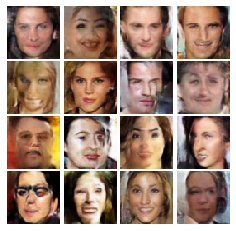


Iter: 15200, D: 0.05687, G:0.5073


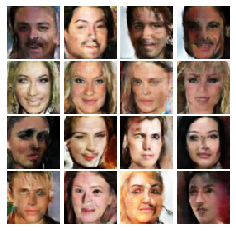


Iter: 15400, D: 0.03171, G:0.5482


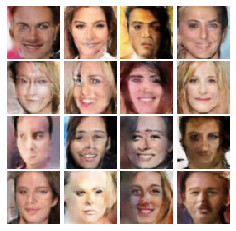


Iter: 15600, D: 0.01103, G:0.49


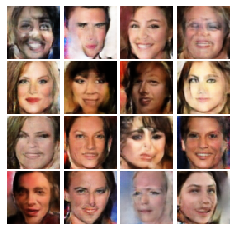


EPOCH:  17
Iter: 15800, D: 0.0381, G:0.4919


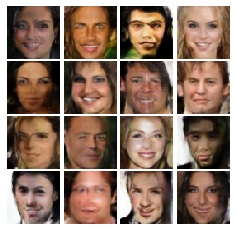


Iter: 16000, D: 0.02015, G:0.5327


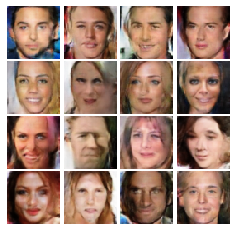


Iter: 16200, D: 0.02556, G:0.5622


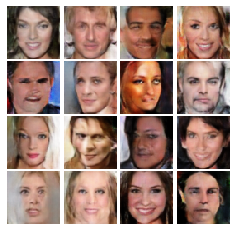


Iter: 16400, D: 0.01931, G:0.5437


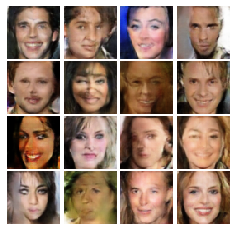


Iter: 16600, D: 0.01043, G:0.3884


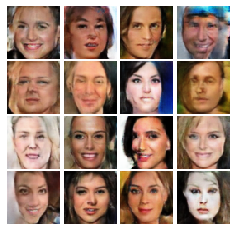


EPOCH:  18
Iter: 16800, D: 0.01815, G:0.5144


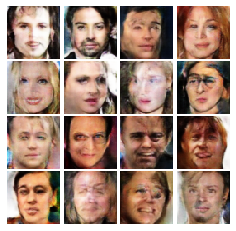


Iter: 17000, D: 0.01337, G:0.4113


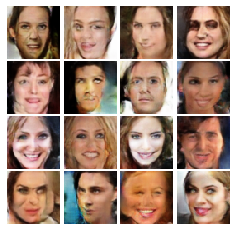


Iter: 17200, D: 0.04834, G:0.492


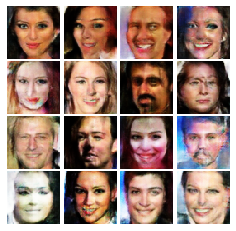


Iter: 17400, D: 0.01196, G:0.3313


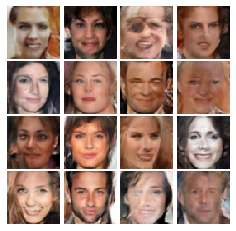


Iter: 17600, D: 0.01789, G:0.3796


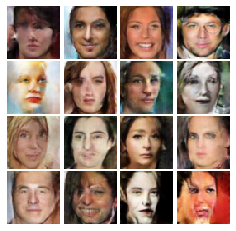


EPOCH:  19
Iter: 17800, D: 0.01543, G:0.4835


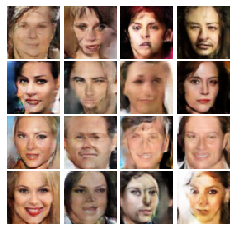


Iter: 18000, D: 0.01058, G:0.5481


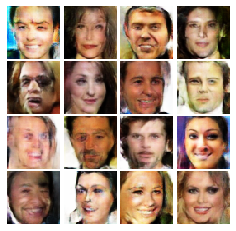


Iter: 18200, D: 0.0202, G:0.4993


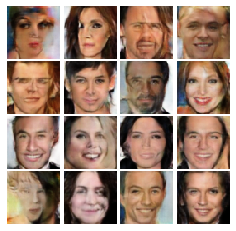


Iter: 18400, D: 0.04354, G:0.5786


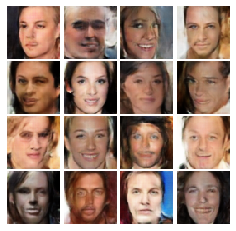


Iter: 18600, D: 0.06781, G:0.3238


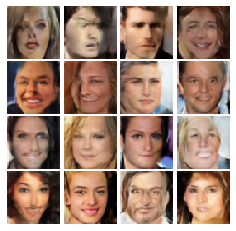


EPOCH:  20
Iter: 18800, D: 0.02665, G:0.5668


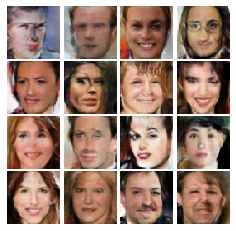


Iter: 19000, D: 0.03838, G:0.632


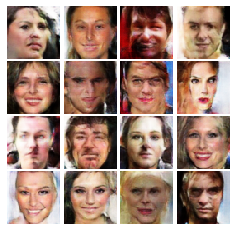


Iter: 19200, D: 0.1081, G:0.5024


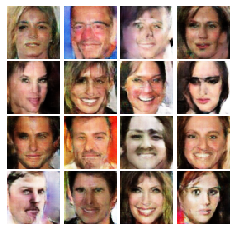


Iter: 19400, D: 0.02928, G:0.5606


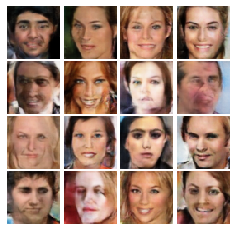


Iter: 19600, D: 0.01053, G:0.5636


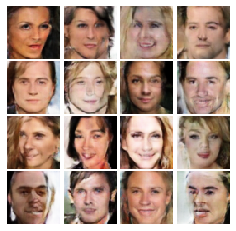

In [16]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=200,
          train_loader=celeba_loader_train, device=device)